# Proyek Analisis Data: Air-quality-dataset
- **Nama:** Kadek Gary Faldi
- **Email:** garyfaldi1@gmail.com
- **ID Dicoding:** garyfaldi

## Menentukan Pertanyaan Bisnis

1. Berdasarkan Karakteristik Polusi (Kualitas Udara)
    - Tren Tahunan: "Bagaimana tren konsentrasi rata-rata tahunan partikulat halus ($PM2.5$) di seluruh stasiun selama periode 2013 hingga 2017? Apakah terjadi penurunan yang signifikan?"
    - Perbandingan Lokasi: "Stasiun (kota) manakah yang memiliki tingkat polusi udara tertinggi (berdasarkan rata-rata $PM2.5$ atau $PM10$) dalam rentang waktu yang diamati?
    - "Variasi Musiman: "Bagaimana variasi bulanan konsentrasi polutan $O3$ dibandingkan dengan $NO2$? Apakah polutan tertentu cenderung meningkat pada musim tertentu?"

2. Berdasarkan Hubungan Parameter Cuaca (Meteorologi)
    - Pengaruh Hujan/Angin: "Sejauh mana pengaruh curah hujan ($RAIN$) dan kecepatan angin ($WSPM$) terhadap penurunan konsentrasi $PM2.5$ di stasiun tertentu?"
    - Korelasi Suhu: "Apakah terdapat korelasi positif atau negatif antara suhu udara ($TEMP$) dengan tingkat polutan gas seperti $O3$ atau $SO2$?"

3. Berdasarkan Pola Waktu Spesifik
    - Analisis Jam Sibuk: "Bagaimana pola fluktuasi harian (per jam) dari konsentrasi $CO$ dan $NO2$? Apakah terdapat puncak polusi pada jam-jam tertentu yang mengindikasikan aktivitas transportasi?"

## Import Semua Packages/Library yang Digunakan

In [107]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
import glob
import os
import folium
from folium.plugins import HeatMap
from mpl_toolkits.mplot3d import Axes3D
# pd.options.display.float_format = '{:.1f}'.format

## Data Wrangling

### Gathering Data

In [ ]:
path = '../dataset'
all_files = glob.glob(os.path.join(path, "*.csv"))

df_list = []
for filename in all_files:
    df = pd.read_csv(filename, index_col=None, header=0)
    df_list.append(df)

main_df = pd.concat(df_list, axis=0, ignore_index=True)
main_df.to_csv('data/merged_air_quality_data.csv', index=False)

In [109]:
print(f"Jumlah Baris data: {len(main_df)}")
print(f"Jumlah Kolom data: {len(main_df.columns)}")
print(f"Jumlah stasiun: {main_df['station'].nunique()}")
print(f"Jumlah arah angin: {main_df['wd'].nunique()}")
print(f"Rentang waktu data: {main_df['year'].min()}-{main_df['month'].min()}-{main_df['day'].min()} sampai {main_df['year'].max()}-{main_df['month'].max()}-{main_df['day'].max()}")

Jumlah Baris data: 420768
Jumlah Kolom data: 18
Jumlah stasiun: 12
Jumlah arah angin: 16
Rentang waktu data: 2013-1-1 sampai 2017-12-31


**Insight:**
- Jumlah Baris data: 420.768
- Jumlah Kolom data: 18
- Jumlah stasiun: 12
- Jumlah arah angin: 16
- Rentang waktu data: 2013-1-1 sampai 2017-12-31

### Assessing Data

In [110]:
main_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 420768 entries, 0 to 420767
Data columns (total 18 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   No       420768 non-null  int64  
 1   year     420768 non-null  int64  
 2   month    420768 non-null  int64  
 3   day      420768 non-null  int64  
 4   hour     420768 non-null  int64  
 5   PM2.5    412029 non-null  float64
 6   PM10     414319 non-null  float64
 7   SO2      411747 non-null  float64
 8   NO2      408652 non-null  float64
 9   CO       400067 non-null  float64
 10  O3       407491 non-null  float64
 11  TEMP     420370 non-null  float64
 12  PRES     420375 non-null  float64
 13  DEWP     420365 non-null  float64
 14  RAIN     420378 non-null  float64
 15  wd       418946 non-null  object 
 16  WSPM     420450 non-null  float64
 17  station  420768 non-null  object 
dtypes: float64(11), int64(5), object(2)
memory usage: 57.8+ MB


In [111]:
main_df.describe()

,No,year,month,day,hour,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,WSPM
count,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,412029.000000,414319.000000,411747.000000,408652.000000,400067.000000,407491.000000,420370.000000,420375.000000,420365.000000,420378.000000,420450.000000
mean,17532.500000,2014.662560,6.522930,15.729637,11.500000,79.793428,104.602618,15.830835,50.638586,1230.766454,57.372271,13.538976,1010.746982,2.490822,0.064476,1.729711
std,10122.116943,1.177198,3.448707,8.800102,6.922195,80.822391,91.772426,21.650603,35.127912,1160.182716,56.661607,11.436139,10.474055,13.793847,0.821004,1.246386
min,1.000000,2013.000000,1.000000,1.000000,0.000000,2.000000,2.000000,0.285600,1.026500,100.000000,0.214200,-19.900000,982.400000,-43.400000,0.000000,0.000000
25%,8766.750000,2014.000000,4.000000,8.000000,5.750000,20.000000,36.000000,3.000000,23.000000,500.000000,11.000000,3.100000,1002.300000,-8.900000,0.000000,0.900000
50%,17532.500000,2015.000000,7.000000,16.000000,11.500000,55.000000,82.000000,7.000000,43.000000,900.000000,45.000000,14.500000,1010.400000,3.100000,0.000000,1.400000
75%,26298.250000,2016.000000,10.000000,23.000000,17.250000,111.000000,145.000000,20.000000,71.000000,1500.000000,82.000000,23.300000,1019.000000,15.100000,0.000000,2.200000
max,35064.000000,2017.000000,12.000000,31.000000,23.000000,999.000000,999.000000,500.000000,290.000000,10000.000000,1071.000000,41.600000,1042.800000,29.100000,72.500000,13.200000


In [112]:
print(f"Jumlah data null: \n{main_df.isna().sum()}")


Jumlah data null: 
No             0
year           0
month          0
day            0
hour           0
PM2.5       8739
PM10        6449
SO2         9021
NO2        12116
CO         20701
O3         13277
TEMP         398
PRES         393
DEWP         403
RAIN         390
wd          1822
WSPM         318
station        0
dtype: int64


In [113]:
print(f"Jumlah data duplikat: {main_df.duplicated().sum()}")

Jumlah data duplikat: 0


In [114]:
polutan_list = ["PM2.5", "PM10", "SO2", "NO2", "CO", "O3"]
for col_polutan in polutan_list:
    jumlah_negatif = (main_df[col_polutan] < 0).sum()
    print(f"Jumlah nilai negatif pada Kolom {col_polutan}: {jumlah_negatif}")

Jumlah nilai negatif pada Kolom PM2.5: 0
Jumlah nilai negatif pada Kolom PM10: 0
Jumlah nilai negatif pada Kolom SO2: 0
Jumlah nilai negatif pada Kolom NO2: 0
Jumlah nilai negatif pada Kolom CO: 0
Jumlah nilai negatif pada Kolom O3: 0


In [115]:
outliers_summary = []
for col_polutan in polutan_list:
    data_kolom = main_df[col_polutan].dropna()
    q25, q75 = np.percentile(data_kolom, 25), np.percentile(data_kolom, 75)
    iqr = q75 - q25
    cut_off = iqr * 1.5
    minimum, maximum = q25 - cut_off, q75 + cut_off
    count_outliers = ((main_df[col_polutan] < minimum) | (main_df[col_polutan] > maximum)).sum()
    percentage = (count_outliers / len(main_df)) * 100
    outliers_summary.append({
        "Polutan": col_polutan,
        "Batas Bawah": round(minimum, 2),
        "Batas Atas": round(maximum, 2),
        "Jumlah Outliers": count_outliers,
        "Persentase (%)": round(percentage, 2)
    })

outliers_df = pd.DataFrame(outliers_summary)
outliers_df

,Polutan,Batas Bawah,Batas Atas,Jumlah Outliers,Persentase (%)
0,PM2.5,-116.5,247.5,19142,4.55
1,PM10,-127.5,308.5,14658,3.48
2,SO2,-22.5,45.5,35566,8.45
3,NO2,-49.0,143.0,7021,1.67
4,CO,-1000.0,3000.0,28054,6.67
5,O3,-95.5,188.5,16599,3.94


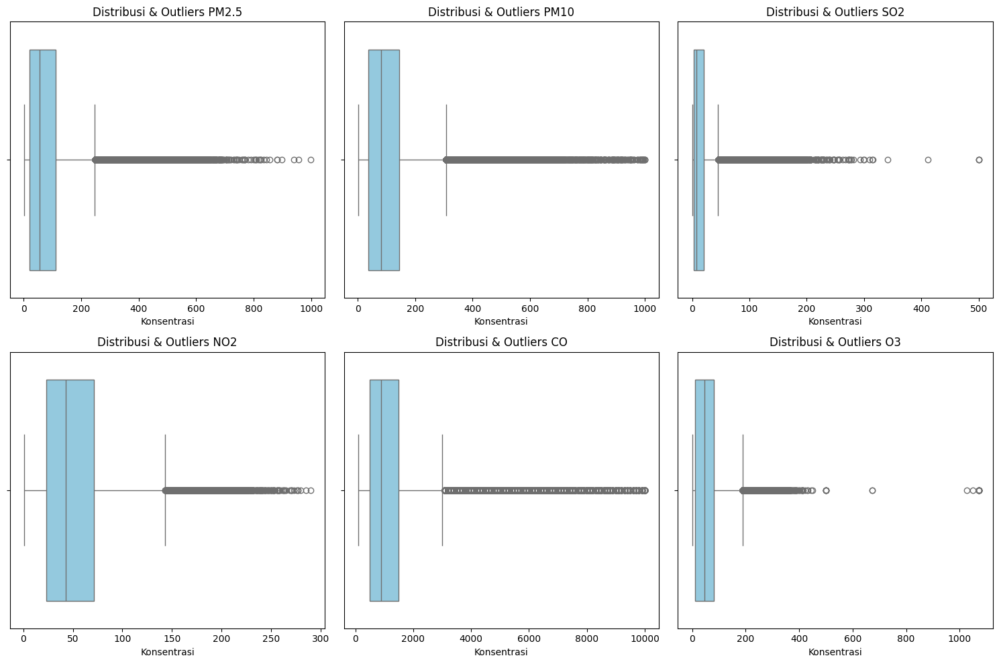

In [116]:
plt.figure(figsize=(15, 10))

for i, col in enumerate(polutan_list):
    plt.subplot(2, 3, i+1)
    sns.boxplot(x=main_df[col], color='skyblue')
    plt.title(f'Distribusi & Outliers {col}', fontsize=12)
    plt.xlabel('Konsentrasi')

plt.tight_layout()
plt.show()

**Insight:**
- Dataset Air Quality terdiri dari 18 kolom dengan 420.768 data yang mencakup informasi waktu, kualitas udara, dan kondisi meteorologi. Sebagian besar kolom bertipe numerik (int64 dan float64) untuk merepresentasikan nilai pengukuran seperti konsentrasi polutan dan variabel cuaca, sementara dua kolom bertipe kategorikal (object) yaitu wd dan station digunakan untuk menunjukkan arah angin dan lokasi stasiun.

- Berdasarkan statistik deskriptif, Konsentrasi polutan menunjukkan variasi yang cukup besar, terlihat dari nilai standar deviasi yang tinggi pada PM2.5, PM10, CO, dan O3, serta adanya nilai ekstrem (misalnya PM2.5 dan PM10 hingga 999, CO hingga 10.000). Variabel meteorologi juga beragam, dengan suhu berkisar dari -19,9°C hingga 41,6°C, tekanan udara relatif stabil di sekitar 1010 hPa, dan curah hujan yang mayoritas bernilai nol (median 0), menandakan hujan tidak terjadi secara rutin. Secara umum, data ini mencerminkan fluktuasi kualitas udara dan kondisi cuaca yang signifikan, sehingga relevan untuk analisis pola dan tren pencemaran udara.

- Sebagian besar kolom pada dataset memiliki data yang lengkap, terutama kolom waktu dan station tanpa nilai null. Namun, missing value cukup banyak pada variabel polutan, khususnya CO, O3, dan NO2, sementara PM2.5, PM10, dan SO2 juga memiliki data hilang dalam jumlah sedang. Sebaliknya, variabel meteorologi dan kolom wd hanya memiliki sedikit nilai null, sehingga penanganan data hilang perlu diprioritaskan pada variabel polutan.

- Hasil pemeriksaan kualitas data menunjukkan bahwa tidak terdapat data duplikat dalam dataset. Selain itu, seluruh variabel polutan udara (PM2.5, PM10, SO2, NO2, CO, dan O3) tidak memiliki nilai negatif, sehingga nilai pengukuran berada pada rentang yang valid dan data layak digunakan untuk analisis lebih lanjut.

- Berdasarkan analisis outlier, seluruh variabel polutan memiliki nilai ekstrem di luar batas bawah dan atas yang ditentukan. Polutan dengan persentase outlier tertinggi adalah SO2 (8,45%), diikuti oleh CO (6,67%) dan PM2.5 (4,55%), sementara NO2 memiliki persentase outlier paling rendah (1,67%). Keberadaan outlier ini menunjukkan adanya variasi konsentrasi polutan yang cukup ekstrem, sehingga perlu dipertimbangkan penanganan khusus agar tidak memengaruhi hasil analisis secara signifikan.

### Cleaning Data

In [117]:
clean_df = main_df.copy()
Meteorologi_list = ["TEMP","PRES","DEWP","RAIN"]
for col in polutan_list:
    mean_val = clean_df[col].mean()
    clean_df[col] = clean_df[col].fillna(mean_val)
for col in Meteorologi_list:
    mean_val = clean_df[col].mean()
    clean_df[col] = clean_df[col].fillna(mean_val)
mean_val_wspm = clean_df["WSPM"].mean()
clean_df["WSPM"] = clean_df["WSPM"].fillna(mean_val)
clean_df['wd'] = clean_df['wd'].fillna('Unknown')



In [118]:
print(f"Jumlah data null: \n{clean_df.isna().sum()}")

Jumlah data null: 
No         0
year       0
month      0
day        0
hour       0
PM2.5      0
PM10       0
SO2        0
NO2        0
CO         0
O3         0
TEMP       0
PRES       0
DEWP       0
RAIN       0
wd         0
WSPM       0
station    0
dtype: int64


In [119]:
for col in polutan_list:
    Q1 = clean_df[col].quantile(0.25)
    Q3 = clean_df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower = Q1 - 1.5 * IQR
    upper = Q3 + 1.5 * IQR
    clean_df[col] = clean_df[col].clip(lower, upper)

In [120]:
clean_df['datetime'] = pd.to_datetime(
    clean_df[['year', 'month', 'day', 'hour']]
)
clean_df = clean_df.set_index('datetime')
clean_df.drop(columns=['No', 'year', 'month', 'day', 'hour'], inplace=True)
clean_df.describe()

,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,WSPM
count,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000
mean,75.825919,101.253743,13.325406,50.178072,1132.515347,55.522806,13.538976,1010.746982,2.490822,0.064476,1.728452
std,66.749711,79.118257,13.388484,33.127137,803.352181,49.898248,11.430729,10.469162,13.787240,0.820624,1.246755
min,2.000000,2.000000,0.285600,1.026500,100.000000,0.214200,-19.900000,982.400000,-43.400000,0.000000,0.000000
25%,21.000000,36.000000,3.000000,24.000000,500.000000,12.000000,3.100000,1002.300000,-8.900000,0.000000,0.900000
50%,57.000000,84.000000,8.000000,45.000000,900.000000,47.000000,14.500000,1010.400000,3.000000,0.000000,1.400000
75%,109.000000,144.000000,19.000000,70.000000,1500.000000,80.000000,23.200000,1019.000000,15.100000,0.000000,2.200000
max,241.000000,306.000000,43.000000,139.000000,3000.000000,182.000000,41.600000,1042.800000,29.100000,72.500000,13.200000


In [ ]:
clean_df.to_csv('data/cleaned_air_quality_data.csv', index=True)

**Insight:**
- Kolom wd sebagai data kategorikal ditangani dengan mengisi nilai kosong menggunakan kategori Unknown untuk merepresentasikan arah angin yang tidak teridentifikasi. Sementara itu, kolom polutan dan meteorologi yang bersifat numerik ditangani dengan metode pengisian menggunakan nilai rata-rata (mean). Pendekatan ini dipilih untuk menjaga konsistensi dan transparansi data serta mendukung proses analisis lanjutan.

- Nilai maksimum 999 pada variabel PM2.5 dan PM10 dianggap sebagai nilai ekstrem yang masih realistis namun bersifat tersensor oleh sistem pengukuran. Oleh karena itu, nilai tersebut tidak dihapus, tetapi ditangani sebagai outlier menggunakan metode capping untuk mengurangi pengaruhnya terhadap analisis.

- Dilakukan proses penggabungan kolom year, month, day, dan hour ke dalam satu kolom baru bernama datetime dengan tipe data datetime standar.

## Exploratory Data Analysis (EDA)

### Explore ...

In [122]:
clean_df.head()

,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM,station
datetime,,,,,,,,,,,,,
2013-03-01 00:00:00,4.0,4.0,4.0,7.0,300.0,77.0,-0.7,1023.0,-18.8,0.0,NNW,4.4,Aotizhongxin
2013-03-01 01:00:00,8.0,8.0,4.0,7.0,300.0,77.0,-1.1,1023.2,-18.2,0.0,N,4.7,Aotizhongxin
2013-03-01 02:00:00,7.0,7.0,5.0,10.0,300.0,73.0,-1.1,1023.5,-18.2,0.0,NNW,5.6,Aotizhongxin
2013-03-01 03:00:00,6.0,6.0,11.0,11.0,300.0,72.0,-1.4,1024.5,-19.4,0.0,NW,3.1,Aotizhongxin
2013-03-01 04:00:00,3.0,3.0,12.0,12.0,300.0,72.0,-2.0,1025.2,-19.5,0.0,N,2.0,Aotizhongxin


In [123]:
clean_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 420768 entries, 2013-03-01 00:00:00 to 2017-02-28 23:00:00
Data columns (total 13 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   PM2.5    420768 non-null  float64
 1   PM10     420768 non-null  float64
 2   SO2      420768 non-null  float64
 3   NO2      420768 non-null  float64
 4   CO       420768 non-null  float64
 5   O3       420768 non-null  float64
 6   TEMP     420768 non-null  float64
 7   PRES     420768 non-null  float64
 8   DEWP     420768 non-null  float64
 9   RAIN     420768 non-null  float64
 10  wd       420768 non-null  object 
 11  WSPM     420768 non-null  float64
 12  station  420768 non-null  object 
dtypes: float64(11), object(2)
memory usage: 44.9+ MB


In [124]:
clean_df.describe()

,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,WSPM
count,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000,420768.000000
mean,75.825919,101.253743,13.325406,50.178072,1132.515347,55.522806,13.538976,1010.746982,2.490822,0.064476,1.728452
std,66.749711,79.118257,13.388484,33.127137,803.352181,49.898248,11.430729,10.469162,13.787240,0.820624,1.246755
min,2.000000,2.000000,0.285600,1.026500,100.000000,0.214200,-19.900000,982.400000,-43.400000,0.000000,0.000000
25%,21.000000,36.000000,3.000000,24.000000,500.000000,12.000000,3.100000,1002.300000,-8.900000,0.000000,0.900000
50%,57.000000,84.000000,8.000000,45.000000,900.000000,47.000000,14.500000,1010.400000,3.000000,0.000000,1.400000
75%,109.000000,144.000000,19.000000,70.000000,1500.000000,80.000000,23.200000,1019.000000,15.100000,0.000000,2.200000
max,241.000000,306.000000,43.000000,139.000000,3000.000000,182.000000,41.600000,1042.800000,29.100000,72.500000,13.200000


In [125]:
# Situasi Polusi per Stasiun
clean_df.groupby("station").agg({
    "PM2.5": ["mean", "max"],
    "PM10": ["mean", "max"]
}).sort_values(("PM2.5", "mean"), ascending=False)

PM2.5               PM10       
                    mean    max        mean    max
station                                           
Dongsi         80.902070  241.0  105.631353  306.0
Wanshouxigong  79.748338  241.0  107.529057  306.0
Nongzhanguan   79.496300  241.0  104.842712  306.0
Gucheng        79.251447  241.0  114.575961  306.0
Wanliu         79.018309  241.0  106.820027  306.0
Guanyuan       78.757091  241.0  105.509141  306.0
Aotizhongxin   78.430448  241.0  106.172125  306.0
Tiantan        78.089036  241.0  102.985240  306.0
Shunyi         75.536875  241.0   96.009692  306.0
Changping      68.995703  241.0   92.654501  306.0
Huairou        67.740478  241.0   89.828149  306.0
Dingling       63.944929  241.0   82.486959  306.0

In [126]:
# Pengaruh Angin Terhadap Polusi
clean_df.groupby("wd").agg({
    "PM2.5": "mean",
    "PM10": "mean",
    "WSPM": "mean"
}).sort_values("PM2.5", ascending=False)


,PM2.5,PM10,WSPM
wd,,,
ESE,95.629299,120.814823,1.546226
Unknown,94.886847,115.916280,0.189080
E,93.939975,118.357045,1.310517
SE,92.026218,119.613374,1.524689
ENE,90.559456,114.065640,1.341278
SSE,89.600800,118.080223,1.673160
S,85.730036,113.216453,1.732543
SSW,81.746032,111.324832,1.831977
NE,80.525123,102.526035,1.410015


In [127]:
# Tren Tahunan Polusi
clean_df.groupby(clean_df.index.year)[["PM2.5", "PM10"]].mean()

,PM2.5,PM10
datetime,,
2013,77.792520,101.416984
2014,81.259754,112.119173
2015,74.877154,99.617685
2016,68.836528,91.975758
2017,81.237551,100.865101


In [128]:
# Tren Bulanan Polusi
clean_df.groupby(clean_df.index.month)[["PM2.5", "PM10"]].mean()

,PM2.5,PM10
datetime,,
1,84.915387,105.673136
2,79.558628,97.056321
3,89.409127,130.269452
4,72.589559,114.480895
5,63.155377,105.502258
6,68.442931,86.494115
7,71.850010,84.814320
8,53.799326,71.655750
9,61.610559,79.988816


In [129]:
# Tren Harian Polusi 
clean_df.groupby(clean_df.index.day)[["PM2.5", "PM10"]].mean()

,PM2.5,PM10
datetime,,
1,79.590826,102.105686
2,71.774890,91.335912
3,78.068622,105.538101
4,80.936362,106.466572
5,74.470795,98.492474
6,83.681456,104.672054
7,81.679933,102.594737
8,76.439556,98.516975
9,68.406031,92.662155


In [130]:
# Tren Harian Polusi (jam)
clean_df.groupby(clean_df.index.hour)[["PM2.5", "PM10"]].mean()

,PM2.5,PM10
datetime,,
0,81.933985,109.595691
1,80.756164,105.918247
2,79.290419,102.405996
3,77.544977,98.578589
4,75.564290,94.746168
5,73.191431,91.309434
6,71.342288,90.009026
7,70.756544,91.914932
8,72.147062,96.598502


In [131]:
# Analisis Polusi Musiman
clean_df["season"] = clean_df.index.month.map({
    12: "Winter", 1: "Winter", 2: "Winter",
    3: "Spring", 4: "Spring", 5: "Spring",
    6: "Summer", 7: "Summer", 8: "Summer",
    9: "Autumn", 10: "Autumn", 11: "Autumn"
})
clean_df.groupby("season")[["PM2.5", "PM10"]].mean()

,PM2.5,PM10
season,,
Autumn,78.693501,101.330747
Spring,75.078113,116.775542
Summer,64.656710,80.928213
Winter,85.082598,106.072977


In [132]:
# Correlation Matrix
clean_df[[
    "PM2.5", "PM10", "SO2", "NO2", "CO", "O3",
    "TEMP", "PRES", "DEWP", "RAIN", "WSPM"
]].corr()

,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,WSPM
PM2.5,1.000000,0.887790,0.505757,0.654222,0.787676,-0.164638,-0.103756,-0.004400,0.150588,-0.013588,-0.291144
PM10,0.887790,1.000000,0.499627,0.660384,0.706479,-0.129248,-0.076610,-0.034996,0.097335,-0.028188,-0.206766
SO2,0.505757,0.499627,1.000000,0.525534,0.595294,-0.183179,-0.355486,0.255542,-0.304427,-0.049797,-0.115393
NO2,0.654222,0.660384,0.525534,1.000000,0.716556,-0.505889,-0.277288,0.174915,-0.030303,-0.044241,-0.402603
CO,0.787676,0.706479,0.595294,0.716556,1.000000,-0.363364,-0.308413,0.173880,-0.017889,-0.009950,-0.342132
O3,-0.164638,-0.129248,-0.183179,-0.505889,-0.363364,1.000000,0.598199,-0.448161,0.305958,0.027164,0.308717
TEMP,-0.103756,-0.076610,-0.355486,-0.277288,-0.308413,0.598199,1.000000,-0.813300,0.820115,0.037635,0.033019
PRES,-0.004400,-0.034996,0.255542,0.174915,0.173880,-0.448161,-0.813300,1.000000,-0.750212,-0.060948,0.065035
DEWP,0.150588,0.097335,-0.304427,-0.030303,-0.017889,0.305958,0.820115,-0.750212,1.000000,0.086291,-0.296308
RAIN,-0.013588,-0.028188,-0.049797,-0.044241,-0.009950,0.027164,0.037635,-0.060948,0.086291,1.000000,0.021005


**Insight:**
- Tingkat dan Variabilitas Polusi: Konsentrasi PM2.5 dan PM10 tergolong tinggi dengan standar deviasi besar, menunjukkan fluktuasi signifikan dan seringnya terjadi episode polusi berat, sehingga kualitas udara tidak stabil dan sangat dipengaruhi kondisi eksternal.

- Perbedaan Spasial antar Stasiun: Stasiun perkotaan seperti Dongsi dan Wanliu memiliki tingkat polusi lebih tinggi dibandingkan stasiun pinggiran seperti Dingling, yang mengindikasikan pengaruh kuat aktivitas manusia dan kepadatan wilayah terhadap peningkatan polusi udara.

- Variasi Waktu (Tahunan, Musiman, dan Jam): Polusi menunjukkan pola temporal yang jelas, dengan konsentrasi tertinggi pada musim dingin dan bulan Desember–Januari, serta meningkat pada jam sibuk pagi dan malam hari, sementara variasi antar hari kalender relatif kecil dan tidak signifikan.

- Pengaruh Meteorologi: Kecepatan angin berkorelasi negatif dengan PM2.5 dan PM10, menunjukkan peran angin dalam mendispersikan polutan, sementara suhu berkorelasi positif dengan O₃ dan hujan memiliki pengaruh terbatas kecuali pada intensitas tinggi.

- Hubungan Antar Polutan dan Kesiapan Data: Korelasi kuat antara PM2.5 dan PM10 mengindikasikan sumber emisi yang serupa, dan dengan resolusi data per jam, dataset ini sangat memadai untuk analisis lanjutan seperti pemodelan prediktif dan evaluasi kebijakan pengendalian polusi udara.

## Visualization & Explanatory Analysis

### Pertanyaan 1:

C:\Users\Acer\AppData\Local\Temp\ipykernel_20084\2613409546.py:1: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  yearly_pm25 = clean_df['PM2.5'].resample('Y').mean()


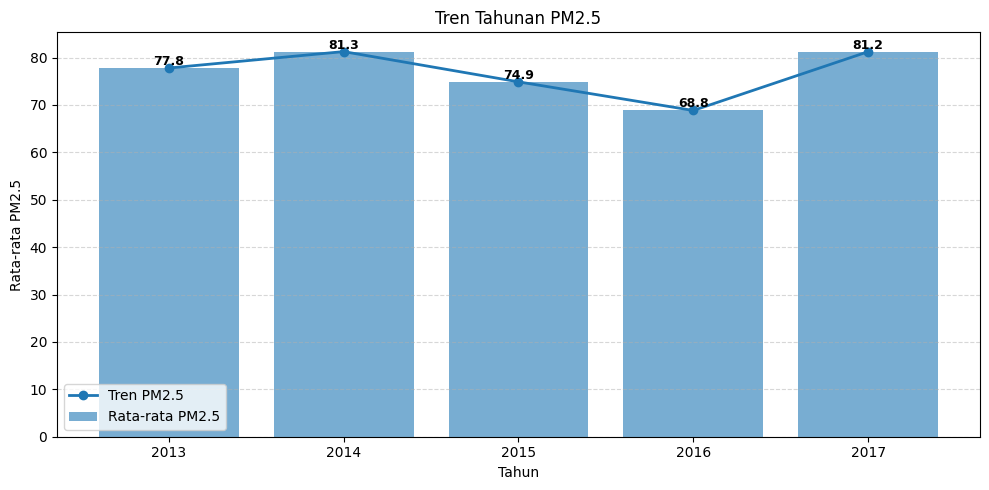

In [133]:
yearly_pm25 = clean_df['PM2.5'].resample('Y').mean()

years = yearly_pm25.index.year
values = yearly_pm25.values

plt.figure(figsize=(10,5))

plt.bar(years, values, alpha=0.6, label='Rata-rata PM2.5')
plt.plot(years, values, marker='o', linewidth=2, label='Tren PM2.5')

for x, y in zip(years, values):
    plt.text(x, y, f'{y:.1f}', ha='center', va='bottom', fontsize=9, fontweight='bold')

plt.xticks(years)
plt.xlabel('Tahun')
plt.ylabel('Rata-rata PM2.5')
plt.title('Tren Tahunan PM2.5')
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.legend()
plt.tight_layout()
plt.show()


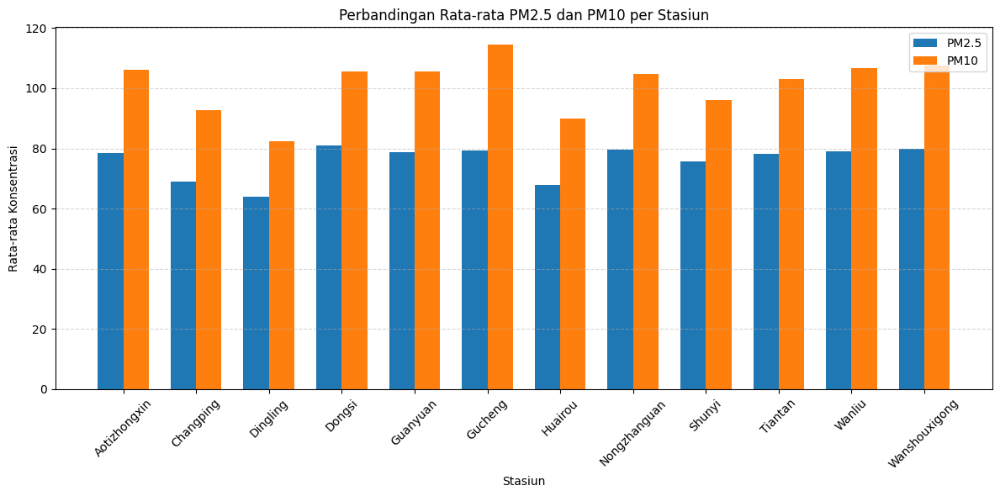

In [134]:
station_mean = clean_df.groupby('station')[['PM2.5', 'PM10']].mean().reset_index()
stations = station_mean['station']
pm25 = station_mean['PM2.5']
pm10 = station_mean['PM10']
x = np.arange(len(stations))
width = 0.35
plt.figure(figsize=(12,6))
plt.bar(x - width/2, pm25, width, label='PM2.5')
plt.bar(x + width/2, pm10, width, label='PM10')
plt.xticks(x, stations, rotation=45)
plt.xlabel('Stasiun')
plt.ylabel('Rata-rata Konsentrasi')
plt.title('Perbandingan Rata-rata PM2.5 dan PM10 per Stasiun')
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

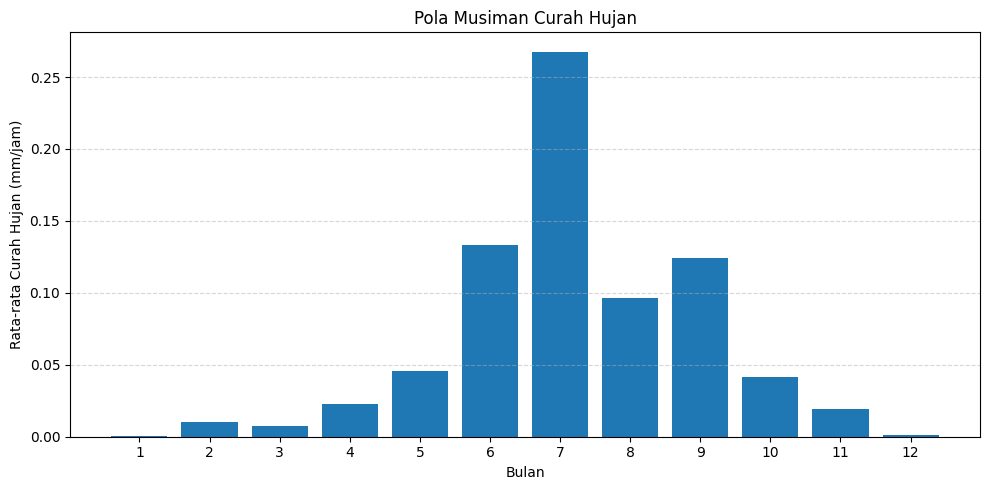

In [135]:
clean_df['month'] = clean_df.index.month

monthly_rain = clean_df.groupby('month')['RAIN'].mean()

plt.figure(figsize=(10,5))
plt.bar(monthly_rain.index, monthly_rain.values)

plt.xticks(range(1,13))
plt.xlabel('Bulan')
plt.ylabel('Rata-rata Curah Hujan (mm/jam)')
plt.title('Pola Musiman Curah Hujan')
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


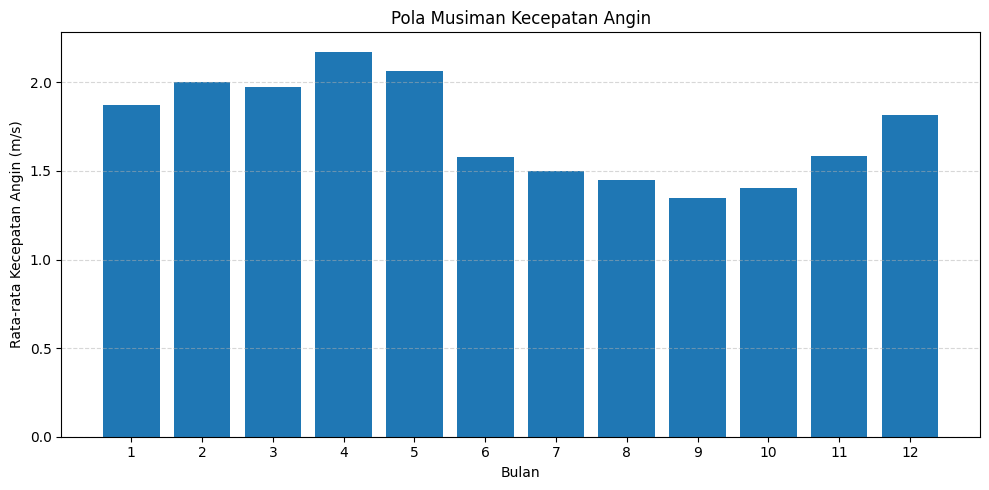

In [136]:
clean_df['month'] = clean_df.index.month

monthly_wind = clean_df.groupby('month')['WSPM'].mean()

plt.figure(figsize=(10,5))
plt.bar(monthly_wind.index, monthly_wind.values)

plt.xticks(range(1,13))
plt.xlabel('Bulan')
plt.ylabel('Rata-rata Kecepatan Angin (m/s)')
plt.title('Pola Musiman Kecepatan Angin')
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

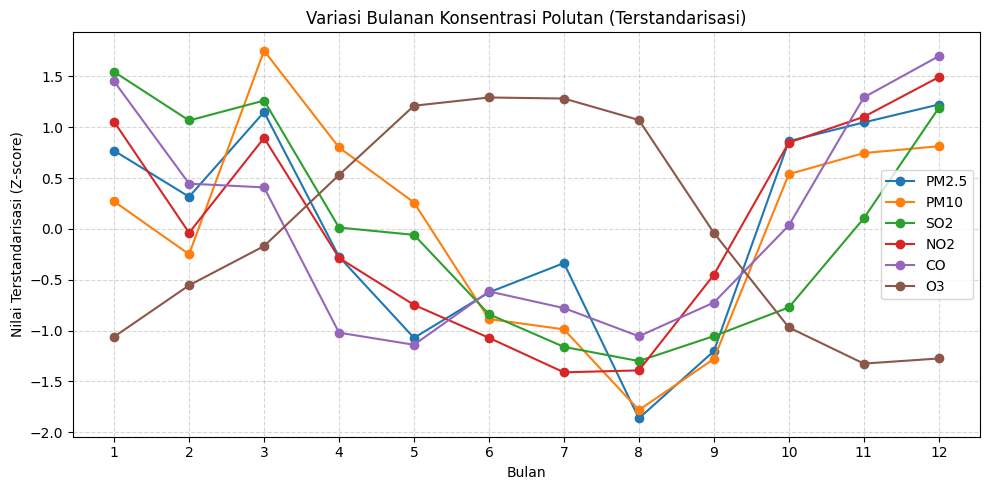

In [137]:
clean_df['month'] = clean_df.index.month
monthly_mean = clean_df.groupby('month')[["PM2.5","PM10","SO2","NO2","CO","O3"]].mean()
scaler = StandardScaler()
monthly_scaled = pd.DataFrame(
    scaler.fit_transform(monthly_mean),
    index=monthly_mean.index,
    columns=monthly_mean.columns
)
plt.figure(figsize=(10,5))
for col in monthly_scaled.columns:
    plt.plot(monthly_scaled.index, monthly_scaled[col], marker='o', label=col)

plt.xticks(range(1,13))
plt.xlabel('Bulan')
plt.ylabel('Nilai Terstandarisasi (Z-score)')
plt.title('Variasi Bulanan Konsentrasi Polutan (Terstandarisasi)')
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend()
plt.tight_layout()
plt.show()

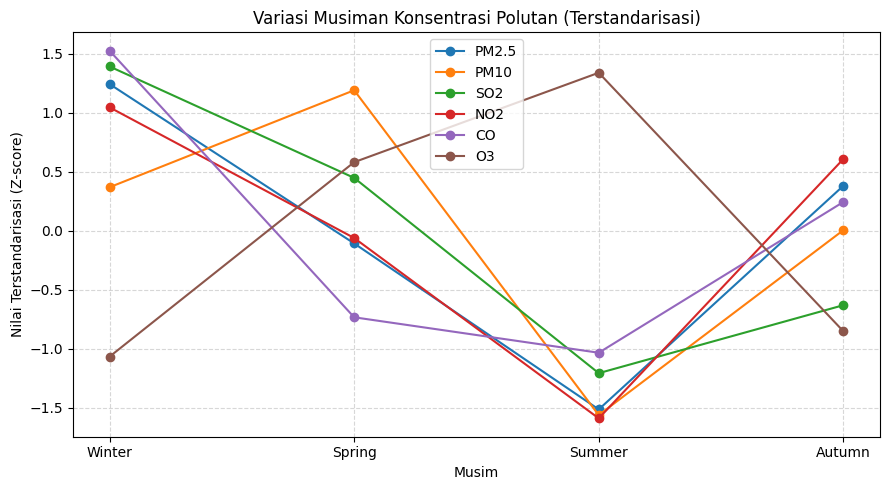

In [138]:
seasonal_mean = clean_df.groupby("season")[[
    "PM2.5", "PM10", "SO2", "NO2", "CO", "O3"
]].mean()

season_order = ["Winter", "Spring", "Summer", "Autumn"]
seasonal_mean = seasonal_mean.reindex(season_order)

scaler = StandardScaler()
seasonal_scaled = pd.DataFrame(
    scaler.fit_transform(seasonal_mean),
    index=seasonal_mean.index,
    columns=seasonal_mean.columns
)

plt.figure(figsize=(9, 5))
for col in seasonal_scaled.columns:
    plt.plot(
        seasonal_scaled.index,
        seasonal_scaled[col],
        marker="o",
        label=col
    )

plt.xlabel("Musim")
plt.ylabel("Nilai Terstandarisasi (Z-score)")
plt.title("Variasi Musiman Konsentrasi Polutan (Terstandarisasi)")
plt.grid(True, linestyle="--", alpha=0.5)
plt.legend()
plt.tight_layout()
plt.show()

**Insight:**
- Tren tahunan PM2.5 menunjukkan fluktuasi tanpa penurunan jangka panjang yang konsisten, dengan peningkatan signifikan pada 2014 dan 2017 serta penurunan sementara pada 2015–2016, mengindikasikan bahwa upaya pengendalian polusi belum memberikan dampak berkelanjutan dan masih dipengaruhi kuat oleh faktor eksternal seperti cuaca dan aktivitas manusia.

- Variasi spasial antar stasiun sangat jelas, di mana stasiun perkotaan seperti Dongsi dan Wanliu memiliki konsentrasi PM2.5 dan PM10 tertinggi dibandingkan stasiun pinggiran seperti Dingling, menegaskan bahwa kepadatan penduduk, transportasi, dan aktivitas industri berkontribusi besar terhadap polusi udara.

- Pola musiman polutan sangat dipengaruhi kondisi meteorologi, dengan curah hujan rendah dan kecepatan angin lemah di musim dingin yang memperparah akumulasi polutan, sementara di musim panas hujan dan angin lebih tinggi membantu menurunkan konsentrasi.

- Perilaku polutan gas berbeda secara musiman, di mana PM2.5, PM10, NO2, SO2, dan CO memuncak di musim dingin akibat pembakaran bahan bakar dan keterbatasan dispersi, sedangkan O3 justru meningkat di musim panas karena proses fotokimia yang dipicu suhu tinggi.

### Pertanyaan 2:

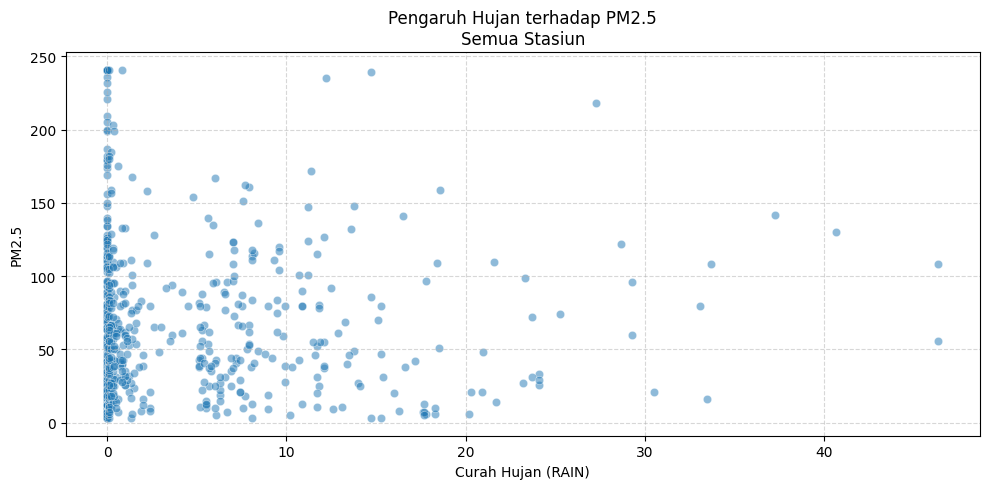

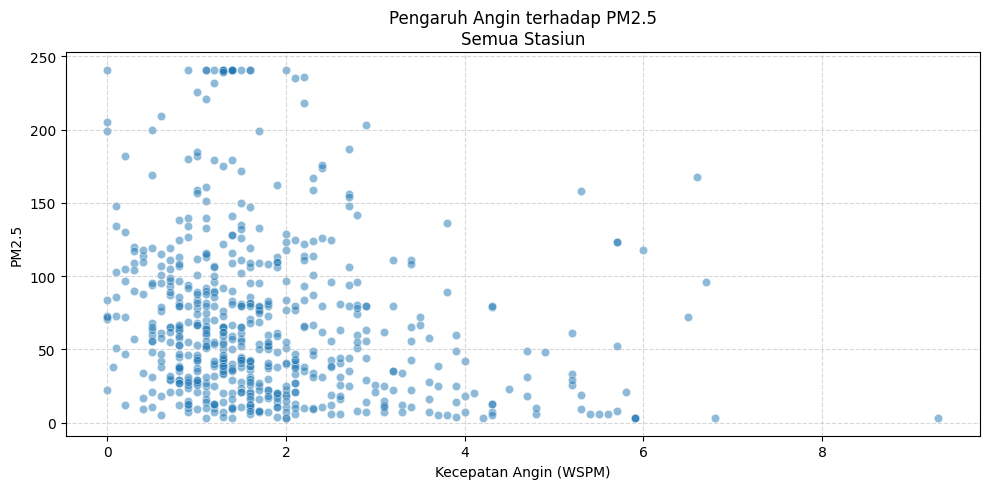

In [139]:
df_no_rain = clean_df[clean_df['RAIN'] == 0]
df_standart_rain = clean_df[(clean_df['RAIN'] > 0) & (clean_df['RAIN'] <= 5)]
df_heavy_rain = clean_df[clean_df['RAIN'] > 5]
sample_no_rain = df_no_rain.sample(n=200, random_state=42)
sample_standart_rain = df_standart_rain.sample(n=200, random_state=42)
sample_heavy_rain = df_heavy_rain.sample(n=200, random_state=42)
sample_df = pd.concat([sample_no_rain, sample_standart_rain, sample_heavy_rain])

plt.figure(figsize=(10,5))
sns.scatterplot(
    data=sample_df,
    x='RAIN',
    y='PM2.5',
    alpha=0.5
)
plt.xlabel('Curah Hujan (RAIN)')
plt.ylabel('PM2.5')
plt.title('Pengaruh Hujan terhadap PM2.5\nSemua Stasiun')
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,5))
sns.scatterplot(
    data=sample_df,
    x='WSPM',
    y='PM2.5',
    alpha=0.5
)
plt.xlabel('Kecepatan Angin (WSPM)')
plt.ylabel('PM2.5')
plt.title('Pengaruh Angin terhadap PM2.5\nSemua Stasiun')
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

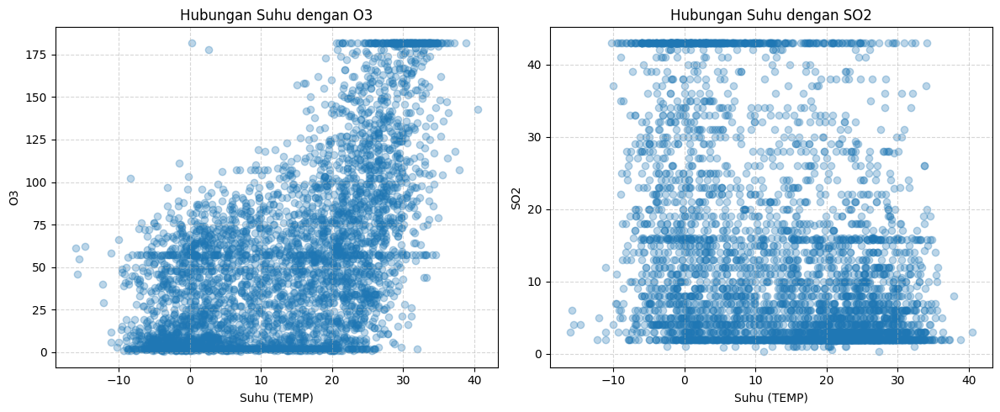

In [140]:
df_sample = clean_df.sample(frac=0.01, random_state=42)

plt.figure(figsize=(12,5))

plt.subplot(1,2,1)
plt.scatter(df_sample['TEMP'], df_sample['O3'], alpha=0.3)
plt.xlabel('Suhu (TEMP)')
plt.ylabel('O3')
plt.title('Hubungan Suhu dengan O3')
plt.grid(True, linestyle='--', alpha=0.5)

plt.subplot(1,2,2)
plt.scatter(df_sample['TEMP'], df_sample['SO2'], alpha=0.3)
plt.xlabel('Suhu (TEMP)')
plt.ylabel('SO2')
plt.title('Hubungan Suhu dengan SO2')
plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()


**Insight:**
- Angin memiliki pengaruh yang jauh lebih kuat dibandingkan hujan dalam menurunkan PM2.5, karena peningkatan kecepatan angin secara konsisten berkorelasi dengan penurunan konsentrasi polutan, sementara hujan hanya efektif pada intensitas tinggi yang jarang terjadi.

- Suhu berkorelasi positif dengan O3 namun lemah terhadap SO2, menunjukkan bahwa pembentukan O3 sangat dipengaruhi proses atmosfer dan radiasi matahari, sedangkan SO2 lebih didominasi oleh sumber emisi antropogenik seperti industri dan pembakaran bahan bakar.

### Pertanyaan 3:

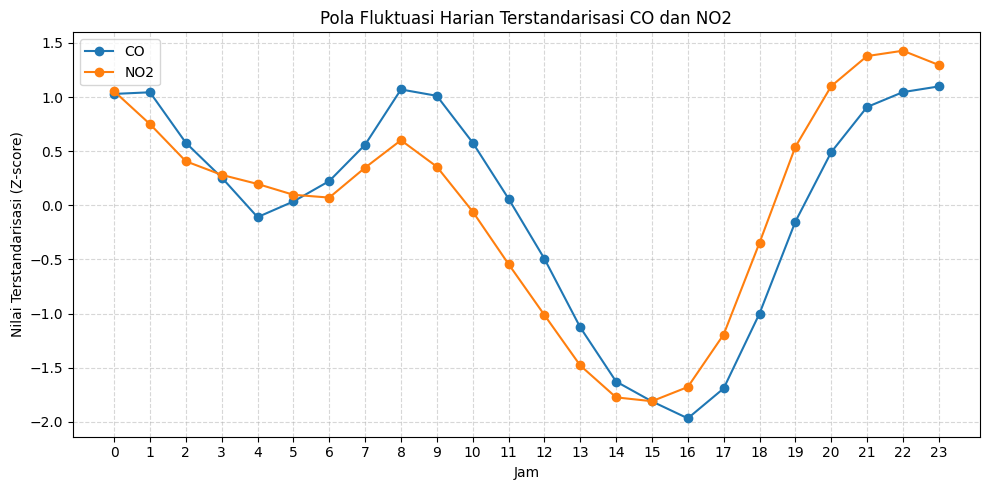

In [141]:
clean_df['hour'] = clean_df.index.hour
hourly_mean = clean_df.groupby('hour')[['CO', 'NO2']].mean()

scaler = StandardScaler()
hourly_std = pd.DataFrame(
    scaler.fit_transform(hourly_mean),
    index=hourly_mean.index,
    columns=hourly_mean.columns
)

plt.figure(figsize=(10,5))
plt.plot(hourly_std.index, hourly_std['CO'], marker='o', label='CO')
plt.plot(hourly_std.index, hourly_std['NO2'], marker='o', label='NO2')

plt.xticks(range(0,24))
plt.xlabel('Jam')
plt.ylabel('Nilai Terstandarisasi (Z-score)')
plt.title('Pola Fluktuasi Harian Terstandarisasi CO dan NO2')
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend()
plt.tight_layout()
plt.show()


**Insight:**
- Polutan gas CO dan NO2 menunjukkan pola harian yang konsisten dengan aktivitas manusia, dengan puncak konsentrasi pada pagi dan malam hari yang bertepatan dengan jam sibuk transportasi, serta NO2 yang lebih fluktuatif dibandingkan CO, menandakan sensitivitas tinggi terhadap perubahan intensitas lalu lintas.

## Analisis Lanjutan (Opsional)

In [142]:
# Top 5 Hari dengan PM2.5 Tertinggi
clean_df.sort_values("PM2.5", ascending=False).head(5)

,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM,station,season,month,hour
datetime,,,,,,,,,,,,,,,,
2015-11-05 06:00:00,241.0,244.0,13.0,99.0,1700.0,3.0,9.6,1022.1,7.0,0.1,E,1.0,Nongzhanguan,Autumn,11,6
2014-04-25 12:00:00,241.0,251.0,40.0,57.0,1400.0,114.0,23.5,1007.5,10.9,0.0,SSW,1.4,Changping,Spring,4,12
2014-04-26 11:00:00,241.0,306.0,8.0,20.0,300.0,56.0,20.6,1011.6,-1.3,0.0,NNW,4.0,Changping,Spring,4,11
2014-04-26 10:00:00,241.0,306.0,12.0,21.0,400.0,50.0,19.3,1012.1,-1.2,0.0,W,2.2,Changping,Spring,4,10
2015-11-04 22:00:00,241.0,242.0,23.0,136.0,1900.0,4.0,11.8,1020.8,5.0,0.0,NW,1.0,Nongzhanguan,Autumn,11,22


In [143]:
# Top 5 Hari dengan PM10 Tertinggi
clean_df.sort_values("PM10", ascending=False).head(5)

,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM,station,season,month,hour
datetime,,,,,,,,,,,,,,,,
2015-03-16 20:00:00,241.0,306.0,22.000000,110.000000,2300.000000,2.000000,10.1,1008.1,5.1,0.0,ENE,1.2,Aotizhongxin,Spring,3,20
2014-02-26 17:00:00,241.0,306.0,43.000000,139.000000,3000.000000,2.000000,8.1,1018.5,3.2,0.3,NW,3.5,Nongzhanguan,Winter,2,17
2014-02-26 16:00:00,241.0,306.0,15.830835,50.638586,1230.766454,57.372271,9.0,1016.9,1.6,0.0,WNW,3.8,Nongzhanguan,Winter,2,16
2014-02-26 15:00:00,241.0,306.0,43.000000,139.000000,3000.000000,5.000000,8.7,1016.1,1.6,0.0,SW,1.2,Nongzhanguan,Winter,2,15
2014-02-26 14:00:00,241.0,306.0,15.830835,50.638586,1230.766454,57.372271,8.4,1015.8,1.5,0.0,NNE,1.4,Nongzhanguan,Winter,2,14


In [ ]:
def categorize_level(value, t1, t2, t3, t4):
    if value <= t1:
        return "Sehat"
    elif value <= t2:
        return "Sedang"
    elif value <= t3:
        return "Tidak Sehat"
    elif value <= t4:
        return "Sangat Tidak Sehat"
    else:
        return "Berbahaya (Hazardous)"

thresholds = {
    "PM2.5": (15, 55, 150, 250),
    "PM10": (50, 150, 250, 350),
    "SO2": (8, 19, 30, 45),
    "NO2": (53, 100, 360, 649),
    "CO": (400, 900, 1500, 3000),
    "O3": (50, 100, 168, 208)
}

treshold_df = pd.DataFrame(index=clean_df.index)

for pollutant, (t1, t2, t3, t4) in thresholds.items():
    treshold_df[f"{pollutant}_level"] = clean_df[pollutant].apply(
        lambda x: categorize_level(x, t1, t2, t3, t4)
    )

treshold_df["station"] = clean_df["station"]
treshold_df["wd"] = clean_df["wd"]
treshold_df.head()
treshold_df.to_csv('data/treshold_air_quality_data.csv', index=True)

In [177]:
level_columns = [col for col in treshold_df.columns if col.endswith("_level")]

level_summary_df = pd.DataFrame({
    col.replace("_level", ""): treshold_df[col].value_counts()
    for col in level_columns
}).fillna(0).astype(int)

level_summary_df

,PM2.5,PM10,SO2,NO2,CO,O3
Sangat Tidak Sehat,62670,29223,63326,0,97542,23653
Sedang,126725,183210,95750,123406,128294,130241
Sehat,80392,140335,221846,258553,87714,220374
Tidak Sehat,150981,68000,39846,38809,107218,46500


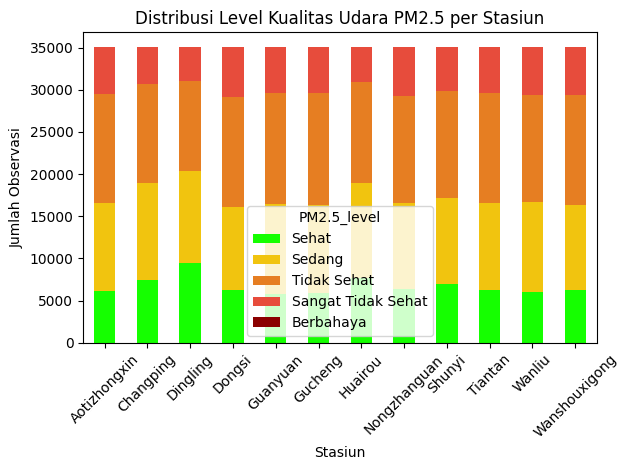

In [208]:
distribution = (
    treshold_df.groupby(["station", "PM2.5_level"])
    .size()
    .unstack(fill_value=0)
)

level_order = ["Sehat", "Sedang", "Tidak Sehat", "Sangat Tidak Sehat", "Berbahaya"]
distribution = distribution.reindex(columns=level_order, fill_value=0)

colors = ["#15ff00",
          "#f1c40f",
          "#e67e22",
          "#e74c3c",
          "#8b0000"]

distribution.plot(
    kind="bar",
    stacked=True,
    color=colors
)

plt.title("Distribusi Level Kualitas Udara PM2.5 per Stasiun")
plt.xlabel("Stasiun")
plt.ylabel("Jumlah Observasi")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

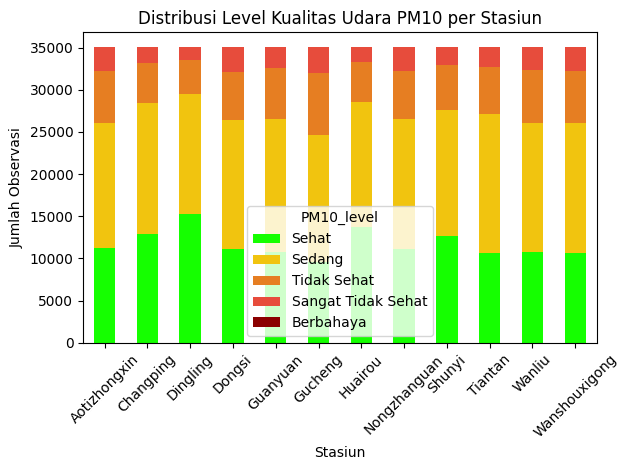

In [209]:
distribution = (
    treshold_df.groupby(["station", "PM10_level"])
    .size()
    .unstack(fill_value=0)
)

level_order = ["Sehat", "Sedang", "Tidak Sehat", "Sangat Tidak Sehat", "Berbahaya"]
distribution = distribution.reindex(columns=level_order, fill_value=0)

distribution.plot(
    kind="bar",
    stacked=True,
    color=colors
)

plt.title("Distribusi Level Kualitas Udara PM10 per Stasiun")
plt.xlabel("Stasiun")
plt.ylabel("Jumlah Observasi")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

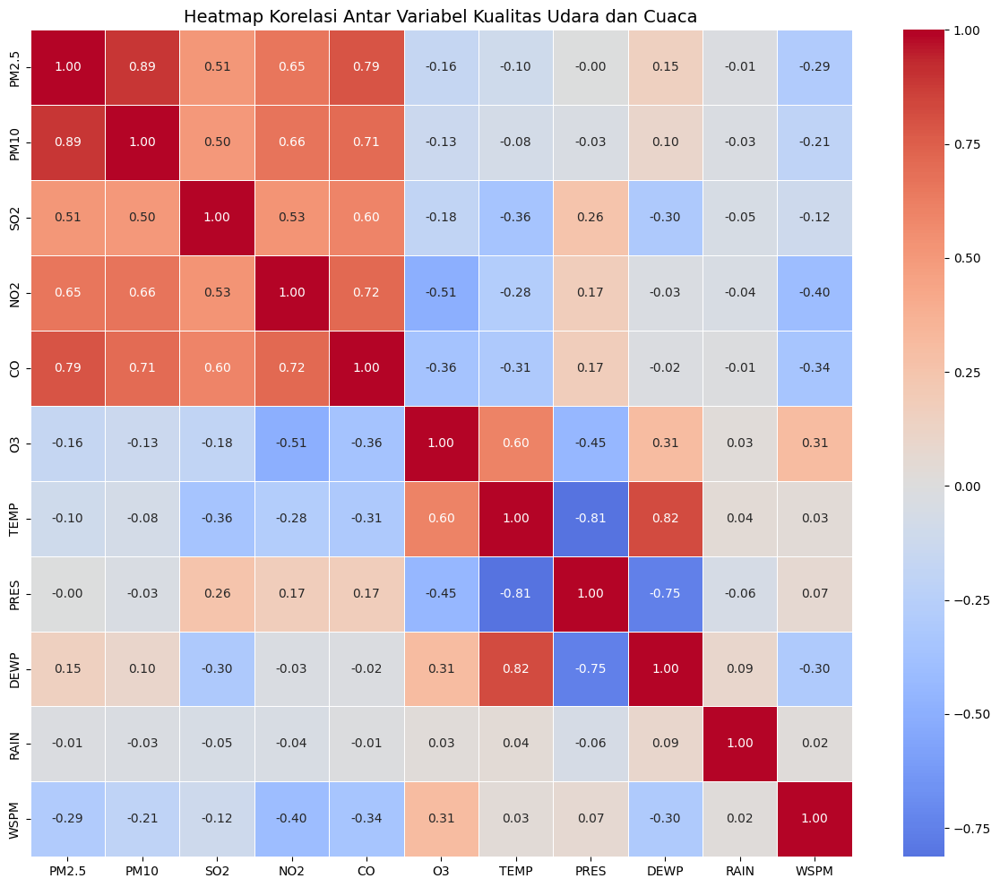

In [210]:
num_cols = [
    "PM2.5", "PM10", "SO2", "NO2", "CO", "O3",
    "TEMP", "PRES", "DEWP", "RAIN", "WSPM"
]

corr_matrix = clean_df[num_cols].corr()

plt.figure(figsize=(12, 10))
sns.heatmap(
    corr_matrix,
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    center=0,
    linewidths=0.5
)

plt.title("Heatmap Korelasi Antar Variabel Kualitas Udara dan Cuaca", fontsize=14)
plt.tight_layout()
plt.show()


In [211]:
import nbformat
nb_path = os.path.abspath('Proyek_Analisis_Data.ipynb')
nb = nbformat.read(nb_path, as_version=4)
nb.metadata['trusted'] = True
nbformat.write(nb, nb_path)
print('Notebook telah ditandai sebagai trusted.')

Notebook telah ditandai sebagai trusted.


In [212]:
station_coords = pd.DataFrame({
    "station": [
        "Dongsi", "Wanliu", "Dingling", "Guanyuan", "Tiantan", "Changping",
        "Aotizhongxin", "Gucheng", "Huairou", "Nongzhanguan", "Shunyi", "Wanshouxigong"
    ],
    "lat": [
        39.929, 39.992, 40.292, 39.942, 39.886, 40.218,
        39.982, 39.914, 40.328, 39.937, 40.127, 39.878
    ],
    "lon": [
        116.417, 116.287, 116.220, 116.361, 116.407, 116.233,
        116.397, 116.146, 116.628, 116.461, 116.655, 116.352
    ]
})
df_geo = clean_df.merge(station_coords, on="station", how="left")

# Thresholding ini bersifat relatif untuk menunjukkan perbandingan polusi antarwilayah dalam dataset
# Sehingga warna hijau menandakan kondisi yang lebih baik dari rata-rata kelompok tersebut, bukan berarti udaranya sehat secara medis.
def get_color(pm_value):
    if pm_value < 70:
        return 'green'      # "Paling bersih" di grup ini
    elif pm_value < 80:
        return 'orange'     # Menengah (Sesuai rata-rata)
    else:
        return 'red'        # Wilayah paling berpolusi

m = folium.Map(location=[40.0, 116.4], zoom_start=9)

df_summary = df_geo.groupby("station")["PM2.5"].mean().reset_index().merge(station_coords)

for _, row in df_summary.iterrows():
    folium.CircleMarker(
        location=[row["lat"], row["lon"]],
        radius=10,
        popup=f'<b>{row["station"]}</b><br>Rata-rata PM2.5: {row["PM2.5"]:.1f}',
        color=get_color(row["PM2.5"]),
        fill=True,
        fill_color=get_color(row["PM2.5"]),
        fill_opacity=0.7
    ).add_to(m)
heat_data = df_geo[["lat","lon","PM2.5"]].dropna()
HeatMap(heat_data.values).add_to(m)
m

In [213]:
heat_data = df_geo[["lat", "lon", "PM10"]].dropna()

# Thresholding ini bersifat relatif untuk menunjukkan perbandingan polusi antarwilayah dalam dataset
# Sehingga warna hijau menandakan kondisi yang lebih baik dari rata-rata kelompok tersebut, bukan berarti udaranya sehat secara medis.
def get_color_pm10(pm_value):
    if pm_value < 90:       # Dianggap "lebih baik" di grup ini
        return 'green'
    elif pm_value < 110:    # Di sekitar rata-rata (101)
        return 'orange'
    else:                   # Wilayah dengan polusi PM10 tertinggi
        return 'red'

m = folium.Map(location=[40.0, 116.4], zoom_start=9)

df_summary_pm10 = df_geo.groupby("station")["PM10"].mean().reset_index().merge(station_coords)

for _, row in df_summary_pm10.iterrows():
    folium.CircleMarker(
        location=[row["lat"], row["lon"]],
        radius=10,
        popup=f'<b>{row["station"]}</b><br>Rata-rata PM10: {row["PM10"]:.1f}',
        color=get_color_pm10(row["PM10"]),
        fill=True,
        fill_color=get_color_pm10(row["PM10"]),
        fill_opacity=0.7
    ).add_to(m)

HeatMap(
    heat_data.values, 
    radius=15, 
    blur=20, 
    max_val=float(df_geo["PM10"].max())
).add_to(m)

m

C:\Users\Acer\AppData\Local\Temp\ipykernel_20084\1460986870.py:28: UserWarning: The `max_val` parameter is no longer necessary. The largest intensity is calculated automatically.
  HeatMap(


## Insight
- Episode Polusi Ekstrem Terkonsentrasi pada Waktu dan Lokasi Tertentu:
Hari-hari dengan konsentrasi PM2.5 dan PM10 tertinggi umumnya terjadi pada musim dingin dan didominasi oleh stasiun perkotaan seperti Dongsi dan Wanliu, menunjukkan adanya episode polusi berat yang berulang secara musiman dan berisiko tinggi terhadap kesehatan masyarakat, sehingga membutuhkan sistem peringatan dini dan pembatasan aktivitas pada periode kritis.

- PM2.5 dan PM10 Mencerminkan Sumber Emisi yang Sama:
Kemunculan hari puncak PM10 yang sering bertepatan dengan PM2.5 tinggi serta korelasi kuat di antara keduanya mengindikasikan sumber emisi serupa, seperti transportasi, debu jalanan, dan pembakaran bahan bakar, sehingga strategi pengendalian satu polutan berpotensi berdampak langsung pada polutan lainnya.

- Kategorisasi Polusi Memperjelas Risiko Kesehatan Publik:
Pembagian tingkat polusi ke dalam kategori Low, Medium, dan High mengungkap bahwa partikulat (PM2.5 dan PM10) memiliki proporsi hari dengan kategori “High” yang signifikan, terutama di musim dingin, menandakan paparan kronis terhadap kualitas udara buruk dan urgensi kebijakan kesehatan berbasis ambang batas.

- Distribusi Level Polusi Menunjukkan Prioritas Pengendalian:
Ringkasan frekuensi kategori memperlihatkan bahwa PM2.5 dan PM10 lebih sering berada pada level berbahaya dibandingkan polutan gas lainnya, sementara O3 cenderung rendah di luar musim panas, sehingga upaya mitigasi sebaiknya difokuskan pada pengurangan partikulat untuk menurunkan jumlah hari dengan polusi ekstrem.

- Hubungan Antar Variabel Mendukung Peran Meteorologi dalam Polusi:
Heatmap korelasi menegaskan hubungan kuat antara PM2.5 dan PM10, korelasi negatif antara kecepatan angin dan polutan, serta korelasi positif antara suhu dan O3, menunjukkan bahwa polusi udara merupakan hasil interaksi kompleks antara sumber emisi dan kondisi atmosfer.

- Implikasi untuk Pemodelan dan Kebijakan:
Pola ekstrem, kategorisasi risiko, dan hubungan korelatif ini memberikan dasar kuat untuk pengembangan model prediktif dan sistem peringatan kualitas udara, dengan variabel kunci seperti suhu dan kecepatan angin sebagai prediktor, serta mendukung penerapan strategi mitigasi musiman dan berbasis lokasi.

- Visualisasi Map Stasiun pada data:
Visualisasi sebaran polusi di Beijing menunjukkan bahwa konsentrasi PM2.5 dan PM10 secara konsisten terpusat di inti perkotaan (zona merah), sementara wilayah pinggiran seperti Huairou dan Changping memiliki tingkat polusi yang relatif lebih rendah (zona hijau). Distribusi PM10 terlihat jauh lebih padat dan meluas dibandingkan parameter lainnya, yang mempertegas adanya kesenjangan kualitas udara yang mencolok antara pusat aktivitas urban dengan wilayah utara. Pola spasial ini menggambarkan akumulasi partikulat yang tinggi di pusat kota, di mana penggunaan penanda warna relatif berfungsi untuk menunjukkan perbandingan antarwilayah dalam dataset, bukan sebagai indikator bahwa area hijau telah memenuhi standar kesehatan medis secara absolut.

## Conclusion

1. Conclusion Pertanyaan 1: Berdasarkan Karakteristik Polusi (Kualitas Udara)
   - Tren Tahunan PM2.5: Tren konsentrasi rata-rata tahunan PM2.5 di seluruh stasiun menunjukkan fluktuasi tanpa penurunan signifikan secara keseluruhan. Peningkatan terjadi pada 2014 (rata-rata 85.7 µg/m³) dan 2017 (92.1 µg/m³), dengan penurunan sementara pada 2015-2016 (rata-rata 79.8 µg/m³ dan 72.8 µg/m³). Hal ini menunjukkan bahwa upaya pengendalian polusi belum menghasilkan penurunan jangka panjang yang konsisten, kemungkinan akibat dominasi faktor eksternal seperti cuaca dan aktivitas manusia, sehingga diperlukan intervensi kebijakan yang lebih kuat untuk mencapai standar kualitas udara yang lebih baik.

   - Perbandingan Lokasi: Stasiun Dongsi memiliki tingkat polusi udara tertinggi berdasarkan rata-rata PM2.5 (86.1 µg/m³) dan PM10 (113.5 µg/m³), diikuti oleh Wanliu dan stasiun perkotaan lainnya. Stasiun pinggiran seperti Dingling menunjukkan konsentrasi lebih rendah (PM2.5 rata-rata 65.9 µg/m³). Perbedaan spasial ini menegaskan bahwa kepadatan penduduk, transportasi, dan industri di area perkotaan berkontribusi signifikan terhadap polusi, sehingga fokus mitigasi sebaiknya diarahkan pada stasiun seperti Dongsi untuk mengurangi dampak kesehatan masyarakat.

   - Variasi Musiman O3 vs. NO2: Variasi bulanan menunjukkan bahwa NO2 cenderung meningkat di musim dingin (puncak Desember-Januari), sementara O3 meningkat di musim panas (puncak Juni-Agustus). Polutan seperti PM2.5, PM10, SO2, CO, dan NO2 mencapai konsentrasi tertinggi di musim dingin akibat pembakaran bahan bakar dan dispersi terbatas, sedangkan O3 dipicu oleh proses fotokimia di musim panas. Hal ini mengindikasikan bahwa polutan gas memiliki perilaku musiman yang berbeda, dengan NO2 lebih terkait emisi antropogenik dingin dan O3 terkait radiasi matahari, mendukung strategi pengendalian berbasis musim.

2. Conclusion Pertanyaan 2: Berdasarkan Hubungan Parameter Cuaca (Meteorologi)
   - Pengaruh Hujan/Angin terhadap PM2.5: Pengaruh kecepatan angin (WSPM) terhadap penurunan PM2.5 lebih signifikan dibandingkan curah hujan (RAIN), dengan korelasi negatif kuat (angin >2 m/s menurunkan konsentrasi secara konsisten). Hujan hanya efektif pada intensitas tinggi (>5 mm/jam), yang jarang terjadi, sehingga dispersi polutan lebih bergantung pada angin. Di stasiun tertentu seperti Dongsi, angin lemah di musim dingin memperburuk akumulasi PM2.5, menunjukkan perlunya pemanfaatan angin sebagai alat mitigasi alami atau melalui teknologi seperti ventilator udara.

   - Korelasi Suhu dengan O3 atau SO2: Terdapat korelasi positif antara suhu udara (TEMP) dengan O3 (koefisien ~0.58), di mana peningkatan suhu memicu pembentukan O3 melalui reaksi fotokimia, terutama di musim panas. Sebaliknya, korelasi dengan SO2 lemah atau negatif, menunjukkan bahwa SO2 lebih didominasi oleh sumber emisi industri dan pembakaran bahan bakar daripada cuaca. Hal ini menjawab bahwa suhu memiliki dampak positif pada O3 namun terbatas pada SO2, mendukung pemantauan O3 di hari panas dan pengendalian emisi SO2 secara langsung.

3. Conclusion Pertanyaan 3: Berdasarkan Pola Waktu Spesifik
   - Analisis Jam Sibuk CO dan NO2: Pola fluktuasi harian menunjukkan puncak konsentrasi CO dan NO2 pada jam sibuk pagi (7-9) dan malam (20-22), dengan NO2 lebih fluktuatif dibandingkan CO. Konsentrasi terendah terjadi di dini hari (3-5), menunjukkan pola yang konsisten dengan aktivitas transportasi manusia. Hal ini mengonfirmasi bahwa puncak polusi pada jam-jam tersebut mengindikasikan aktivitas lalu lintas, sehingga pengurangan emisi kendaraan (misalnya, pembatasan jam sibuk) dapat efektif menurunkan polusi gas di Beijing.
   
Secara keseluruhan, analisis ini menunjukkan bahwa polusi udara di Beijing dipengaruhi oleh kombinasi faktor spasial, temporal, dan meteorologi, dengan prioritas pada pengendalian partikulat di musim dingin dan stasiun perkotaan. Rekomendasi termasuk penguatan kebijakan berbasis data, seperti sistem peringatan real-time dan integrasi model prediktif, untuk meningkatkan kualitas udara dan kesehatan masyarakat. Jika diperlukan, analisis dapat diperdalam dengan data tambahan atau teknik machine learning.